## Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import requests
import json
import PIL
import urllib.request

## API
---------

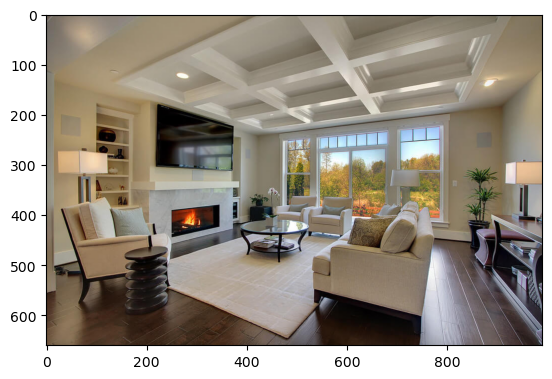

In [2]:
# plot demo image
import PIL
import urllib.request

url = 'https://demo.restb.ai/images/demo/demo-1.jpg'
plt.imshow(np.array(PIL.Image.open(urllib.request.urlopen(url))))
plt.show()

In [3]:
url = 'https://api-eu.restb.ai/vision/v2/multipredict'
payload = {
    # Add the client key to the parameters dictionary
    "client_key": "12f2a63e1748d6ff428a87de8fe7efe2c1a1b144978f229cbe5af681dd36be1e",

    # 'model_id': 're_roomtype_international',
    # 'model_id': 're_roomtype_reso',
    'model_id': 're_features_v4',

    # Add the image URL you want to classify
    'image_url': 'https://demo.restb.ai/images/demo/demo-1.jpg'
}

# Make the classify request
response = requests.get(url, params=payload)

# The response is formatted in JSON
json_response = response.json()

json_response

{'error': 'false',
 'response': {'solutions': {'re_features_v4': {'detections': [{'details': [],
      'label': 'fireplace'},
     {'details': [], 'label': 'coffered_ceiling'},
     {'details': [], 'label': 'tv'},
     {'details': [{'label': 'dark'}], 'label': 'hardwood_floor'},
     {'details': [], 'label': 'natural_light'},
     {'details': [], 'label': 'built_in_shelves'},
     {'details': [], 'label': 'beamed_ceiling'}]}}},
 'time': '2023-05-13T12:37:30.523169',
 'correlation_id': '0a9ca2a4-25ab-4aa0-af16-0e86abffcf0c',
 'version': '2'}

## Load dataset
------

In [33]:
# load
df = pd.read_json('hackupc2023_restbai__dataset.json').T
df

,summary,city,neighborhood,region,price,square_meters,bedrooms,bathrooms,images,num_images,image_data,property_type
0,Casa en calle Urb. Las Mimosas,Ames,San Tome,a_coruna,250000,315,4,3,[https://restb-hackathon.s3.amazonaws.com/real...,31,"{'r1r6': {'property': 4.2, 'kitchen': 4.7, 'ba...",single_family
1,Piso en Milladoiro,Ames,San Tome,a_coruna,90000,72,2,1,[https://restb-hackathon.s3.amazonaws.com/real...,11,"{'r1r6': {'property': 3.5, 'kitchen': 3.4, 'ba...",condo_apartment
2,Casa en calle La Piedra,A Ortigueira,Cariño,a_coruna,50000,92,2,1,[https://restb-hackathon.s3.amazonaws.com/real...,1,"{'r1r6': {'property': None, 'kitchen': None, '...",single_family
3,Casa en Perillo,Perillo,Oleiros,a_coruna,359000,244,4,3,[https://restb-hackathon.s3.amazonaws.com/real...,38,"{'r1r6': {'property': 3.2, 'kitchen': 3.1, 'ba...",single_family
5,Casa en Bergondiño,Bergondo,Carrio,a_coruna,320000,226,4,3,[https://restb-hackathon.s3.amazonaws.com/real...,21,"{'r1r6': {'property': 4.2, 'kitchen': None, 'b...",single_family
...,...,...,...,...,...,...,...,...,...,...,...,...
831429,Finca rústica en Montmeló,Montmeló,None,valles_oriental_sud,518100,5246,None,None,[https://restb-hackathon.s3.amazonaws.com/real...,1,"{'r1r6': {'property': None, 'kitchen': None, '...",single_family
831430,Finca rústica en Cardedeu,Cardedeu,None,valles_oriental_sud,None,4381,None,None,[https://restb-hackathon.s3.amazonaws.com/real...,10,"{'r1r6': {'property': None, 'kitchen': None, '...",single_family
831431,Finca rústica en Granollers,Can Bassa-Palou,Granollers,valles_oriental_sud,None,4063,None,None,[https://restb-hackathon.s3.amazonaws.com/real...,4,"{'r1r6': {'property': None, 'kitchen': None, '...",single_family
831432,Finca rústica en La Roca del Vallès,La Roca del Vallès,None,valles_oriental_sud,1350000,350,5,2,[https://restb-hackathon.s3.amazonaws.com/real...,1,"{'r1r6': {'property': None, 'kitchen': None, '...",single_family


In [5]:
# check how many rows only have one image
df[df['num_images'] >= 10]

,summary,city,neighborhood,region,price,square_meters,bedrooms,bathrooms,images,num_images,image_data,property_type
261286,Piso en Mieres,Baíña-San Pedro-Siana,Mieres,asturias,35000,56,2,1,[https://restb-hackathon.s3.amazonaws.com/real...,22,"{'r1r6': {'property': 4.4, 'kitchen': 3.8, 'ba...",condo_apartment
583208,Casa en Lo Pagán,Lo Pagán,San Pedro del Pinatar,murcia,80000,135,3,2,[https://restb-hackathon.s3.amazonaws.com/real...,15,"{'r1r6': {'property': 4.1, 'kitchen': 4.3, 'ba...",single_family
494663,Piso en Camino de los Planos,Entrena,None,la_rioja,72200,97,2,1,[https://restb-hackathon.s3.amazonaws.com/real...,14,"{'r1r6': {'property': 3.7, 'kitchen': 3.3, 'ba...",condo_apartment
437872,Piso en calle del Pilarillo,Dúrcal,None,valle_de_lecrin,33080,63,2,1,[https://restb-hackathon.s3.amazonaws.com/real...,14,"{'r1r6': {'property': 4.4, 'kitchen': None, 'b...",condo_apartment
819823,"Piso en Avinguda de Pau Casals, cerca de Carre...",Sant Quirze del Vallès,None,valles_occidental_sud,269000,93,3,2,[https://restb-hackathon.s3.amazonaws.com/real...,13,"{'r1r6': {'property': 3.7, 'kitchen': 3.3, 'ba...",condo_apartment
403369,Apartamento en Els Grecs-Mas Oliva,Els Grecs-Mas Oliva,Roses,alt_emporda,138000,60,2,1,[https://restb-hackathon.s3.amazonaws.com/real...,25,"{'r1r6': {'property': 4.3, 'kitchen': 4.0, 'ba...",condo_apartment
126374,Casa adosada en Nordeste-San Lázaro,Nordeste-San Lázaro,Santiago de Compostela,a_coruna,244000,139,4,2,[https://restb-hackathon.s3.amazonaws.com/real...,25,"{'r1r6': {'property': 2.8, 'kitchen': 3.4, 'ba...",single_family
396906,Piso en Lucena,Lucena,None,cordoba,100000,110,4,1,[https://restb-hackathon.s3.amazonaws.com/real...,12,"{'r1r6': {'property': 3.4, 'kitchen': 3.5, 'ba...",condo_apartment
104620,Piso en calle Avd La Sagra,Numancia de La Sagra,None,toledo,95000,115,3,2,[https://restb-hackathon.s3.amazonaws.com/real...,19,"{'r1r6': {'property': 4.4, 'kitchen': 4.2, 'ba...",condo_apartment
479722,Casa en Son Vida,Son Vida,Distrito Ponent. Palma de Mallorca,islas_baleares_illes_balears,1360000,330,3,3,[https://restb-hackathon.s3.amazonaws.com/real...,15,"{'r1r6': {'property': 3.2, 'kitchen': 3.5, 'ba...",single_family


<Axes: >

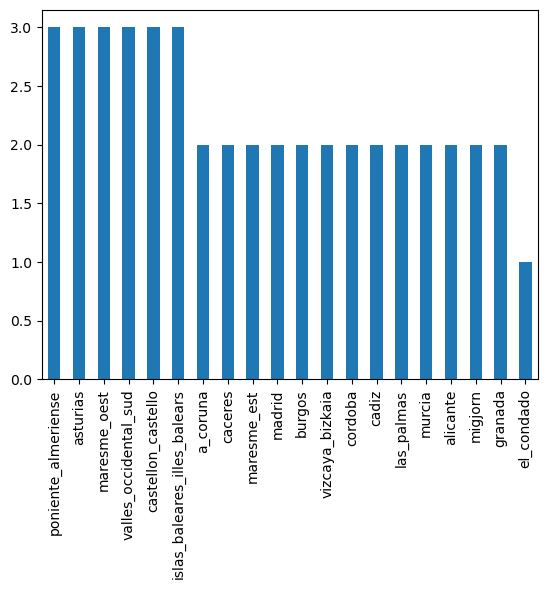

In [6]:
# plot the distribution of the top 20 regions
df['region'].value_counts().head(20).plot(kind='bar')

## Preprocessing
------------

1. Convert the image URLs to PIL objects
2. Expand the R1R6 scores in the "image_data" column as additional columns
3. Only take rows with num_images between 5 and 20
4. Turn the PIL objects into numpy arrays with 96x96 dimensions

In [35]:
# get the values of the "R1R6" key in the "image_data" column
df['image_data_r1r6'] = df['image_data'].apply(lambda x: x['r1r6'])

# if all the values in the "image_data_r1r6" dictionary are None, then remove the row
df = df[df['image_data_r1r6'].apply(lambda x: not all(v is None for v in x.values()))]

# extract the values in the "image_data_r1r6" dictionary into additional columns
df['image_data_r1r6_property'] = df['image_data_r1r6'].apply(lambda x: x['property'])
df['image_data_r1r6_kitchen'] = df['image_data_r1r6'].apply(lambda x: x['kitchen'])
df['image_data_r1r6_bathroom'] = df['image_data_r1r6'].apply(lambda x: x['bathroom'])
df['image_data_r1r6_interior'] = df['image_data_r1r6'].apply(lambda x: x['interior'])

df

C:\Users\natha\AppData\Local\Temp\ipykernel_37948\1020033569.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\natha\AppData\Local\Temp\ipykernel_37948\1020033569.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\natha\AppData\Local\Temp\ipykernel_37948\1020033569.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pand

,summary,city,neighborhood,region,price,square_meters,bedrooms,bathrooms,images,num_images,image_data,property_type,image_data_r1r6,image_data_r1r6_property,image_data_r1r6_kitchen,image_data_r1r6_bathroom,image_data_r1r6_interior
0,Casa en calle Urb. Las Mimosas,Ames,San Tome,a_coruna,250000,315,4,3,[https://restb-hackathon.s3.amazonaws.com/real...,31,"{'r1r6': {'property': 4.2, 'kitchen': 4.7, 'ba...",single_family,"{'property': 4.2, 'kitchen': 4.7, 'bathroom': ...",4.2,4.7,4.0,4.0
1,Piso en Milladoiro,Ames,San Tome,a_coruna,90000,72,2,1,[https://restb-hackathon.s3.amazonaws.com/real...,11,"{'r1r6': {'property': 3.5, 'kitchen': 3.4, 'ba...",condo_apartment,"{'property': 3.5, 'kitchen': 3.4, 'bathroom': ...",3.5,3.4,3.5,3.7
3,Casa en Perillo,Perillo,Oleiros,a_coruna,359000,244,4,3,[https://restb-hackathon.s3.amazonaws.com/real...,38,"{'r1r6': {'property': 3.2, 'kitchen': 3.1, 'ba...",single_family,"{'property': 3.2, 'kitchen': 3.1, 'bathroom': ...",3.2,3.1,3.6,3.0
5,Casa en Bergondiño,Bergondo,Carrio,a_coruna,320000,226,4,3,[https://restb-hackathon.s3.amazonaws.com/real...,21,"{'r1r6': {'property': 4.2, 'kitchen': None, 'b...",single_family,"{'property': 4.2, 'kitchen': None, 'bathroom':...",4.2,NaN,4.4,4.0
7,Apartamento en Cuatro Caminos,Catro Camiños-A Gaiteira,A Coruña Capital,a_coruna,102000,48,1,1,[https://restb-hackathon.s3.amazonaws.com/real...,10,"{'r1r6': {'property': 4.2, 'kitchen': 4.5, 'ba...",condo_apartment,"{'property': 4.2, 'kitchen': 4.5, 'bathroom': ...",4.2,4.5,4.5,3.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
831397,Dúplex en calle Santa Maria del Jaire,La Torreta,La Roca del Vallès,valles_oriental_sud,290000,123,4,2,[https://restb-hackathon.s3.amazonaws.com/real...,1,"{'r1r6': {'property': 4.2, 'kitchen': 4.2, 'ba...",condo_apartment,"{'property': 4.2, 'kitchen': 4.2, 'bathroom': ...",4.2,4.2,NaN,NaN
831404,Dúplex en Pueblo,Lliçà d'Amunt,None,valles_oriental_sud,222260,140,4,2,[https://restb-hackathon.s3.amazonaws.com/real...,9,"{'r1r6': {'property': 3.7, 'kitchen': 4.2, 'ba...",condo_apartment,"{'property': 3.7, 'kitchen': 4.2, 'bathroom': ...",3.7,4.2,3.4,3.7
831406,Dúplex en Cardedeu,Cardedeu,None,valles_oriental_sud,229500,176,4,3,[https://restb-hackathon.s3.amazonaws.com/real...,26,"{'r1r6': {'property': 3.9, 'kitchen': 3.7, 'ba...",condo_apartment,"{'property': 3.9, 'kitchen': 3.7, 'bathroom': ...",3.9,3.7,4.1,3.8
831420,Finca rústica en Vilanova del Vallès,Vilanova del Vallès,None,valles_oriental_sud,394000,445,4,2,[https://restb-hackathon.s3.amazonaws.com/real...,40,"{'r1r6': {'property': 4.4, 'kitchen': 4.5, 'ba...",single_family,"{'property': 4.4, 'kitchen': 4.5, 'bathroom': ...",4.4,4.5,4.6,4.1


In [36]:
# only take rows where the number of images are between 5 to 20
df = df[(df['num_images'] >= 5) & (df['num_images'] <= 20)]
df.shape

(184162, 17)

In [38]:
# remove rows with nan values in the "price" column
df = df[~df['price'].isna()]
df.shape

(182881, 17)

In [40]:
# remove those rows with a nan value in at least one of the r1r6 columns
df = df[~df[['image_data_r1r6_property', 'image_data_r1r6_kitchen', 'image_data_r1r6_bathroom', 'image_data_r1r6_interior']].isna().any(axis=1)]
df.shape

(122228, 17)

In [42]:
# remove rows with a nan value
cleaned_df = df.dropna()
cleaned_df.shape

(71428, 17)

In [43]:
# take 10000 random rows from the cleaned dataframe
cleaned_df = cleaned_df.sample(10000, random_state=42)
cleaned_df.shape

(10000, 17)

In [48]:
# use multithreading to download the images in the "images" column of the cleaned_df dataframe
import threading
import time
import urllib.request
import os

def download_image(url, filename):
    urllib.request.urlretrieve(url, filename)

def download_images(df, folder):
    for index, row in df.iterrows():
        for i in range(len(row['images'])):
            url = row['images'][i]
            filename = os.path.join(folder, f'{index}_{i}.jpg')
            threading.Thread(target=download_image, args=(url, filename)).start()

# create a folder to store the images
os.makedirs('images', exist_ok=True)

# download the images
download_images(cleaned_df, 'images')

Exception in thread Thread-67735:
Traceback (most recent call last):
  File "c:\Users\natha\miniconda3\envs\hack\lib\urllib\request.py", line 1346, in do_open
    h.request(req.get_method(), req.selector, req.data, headers,
  File "c:\Users\natha\miniconda3\envs\hack\lib\http\client.py", line 1285, in request
    self._send_request(method, url, body, headers, encode_chunked)
  File "c:\Users\natha\miniconda3\envs\hack\lib\http\client.py", line 1331, in _send_request
    self.endheaders(body, encode_chunked=encode_chunked)
  File "c:\Users\natha\miniconda3\envs\hack\lib\http\client.py", line 1280, in endheaders
    self._send_output(message_body, encode_chunked=encode_chunked)
  File "c:\Users\natha\miniconda3\envs\hack\lib\http\client.py", line 1040, in _send_output
    self.send(msg)
  File "c:\Users\natha\miniconda3\envs\hack\lib\http\client.py", line 980, in send
    self.connect()
  File "c:\Users\natha\miniconda3\envs\hack\lib\http\client.py", line 1454, in connect
    self.sock =

super().connect()
  File "c:\Users\natha\miniconda3\envs\hack\lib\socket.py", line 954, in getaddrinfo

super().connect()

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "c:\Users\natha\miniconda3\envs\hack\lib\threading.py", line 980, in _bootstrap_inner
  File "c:\Users\natha\miniconda3\envs\hack\lib\socket.py", line 954, in getaddrinfo
  File "c:\Users\natha\miniconda3\envs\hack\lib\http\client.py", line 946, in connect
self.sock = self._create_connection(
  File "c:\Users\natha\miniconda3\envs\hack\lib\socket.py", line 823, in create_connection
: [Errno 11001] getaddrinfo failed        super().connect()    super().connect()

    self.send(msg)
raise URLError(err)raise URLError(err)
for res in _socket.getaddrinfo(host, port, family, type, proto, flags):
socket.    self.sock = self._create_connection(
for res in _socket.getaddrinfo(host, port, family, type, proto, flags):
  File "c:\Users\natha\miniconda3\envs\hack\lib\h

In [54]:
cleaned_df.region.value_counts()

leon                            267
malaga                          195
alicante                        174
castellon_castello              171
tierras_de_leon                 166
                               ... 
la_montana_de_riano               1
area_de_la_jonquera_peralada      1
muros_xallas                      1
les_franqueses_del_valles         1
goierri                           1
Name: region, Length: 324, dtype: int64

In [44]:
# convert the image urls in "images" column to PIL images
cleaned_df['images_pil'] = cleaned_df['images'].apply(lambda x: [PIL.Image.open(urllib.request.urlopen(url)) for url in x])

KeyboardInterrupt: 

In [23]:
# transform the PIL images into numpy arrays of size 96x96
cleaned_df['images_np'] = cleaned_df['images_pil'].apply(lambda x: [np.array(img.resize((96, 96))) for img in x])

C:\Users\natha\AppData\Local\Temp\ipykernel_37948\1201711326.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['images_np'] = df['images_pil'].apply(lambda x: [np.array(img.resize((96, 96))) for img in x])


In [45]:
# save df as preprocessed dataset
cleaned_df.to_json('preprocessed_10k.json', orient='index')

## Data visualization
---------

In [32]:
# visualize the price distribution in the regions with a map
import plotly.express as px

fig = px.choropleth(df, locations="region", color="price", hover_name="region", color_continuous_scale=px.colors.sequential.Plasma)
fig.show()

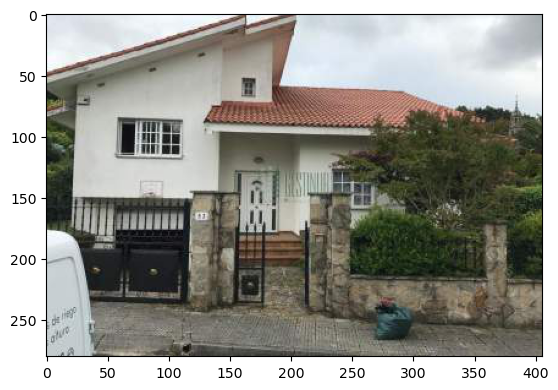

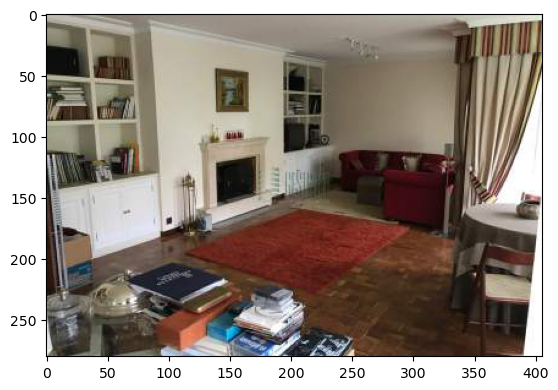

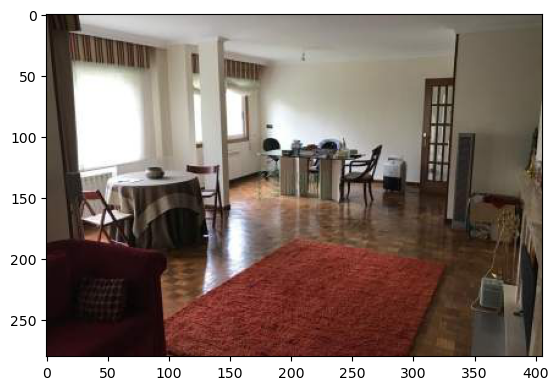

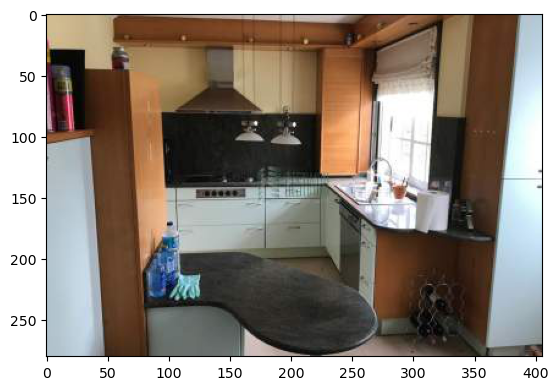

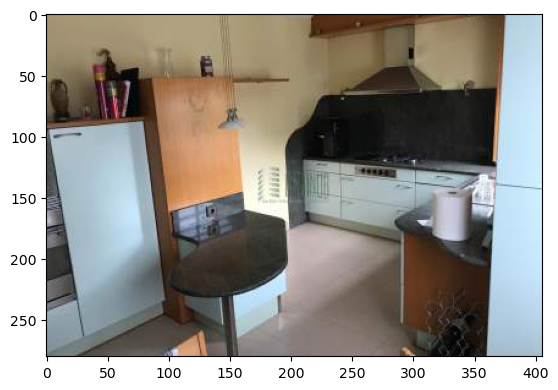

...

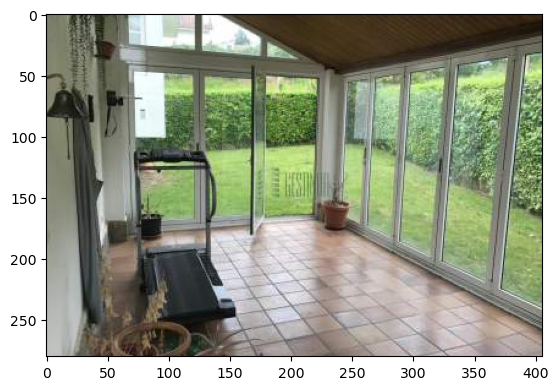

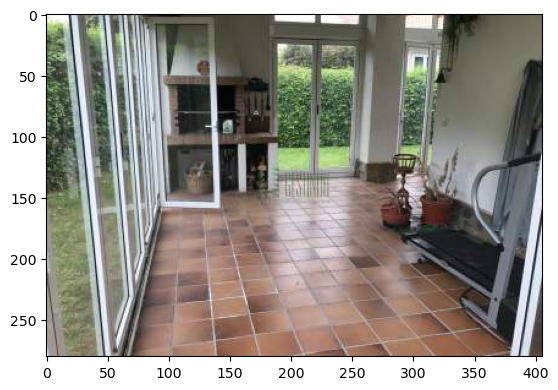

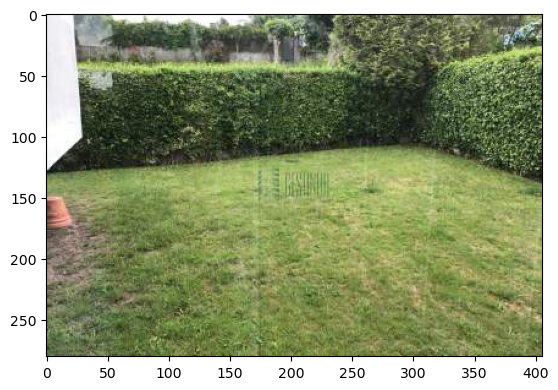

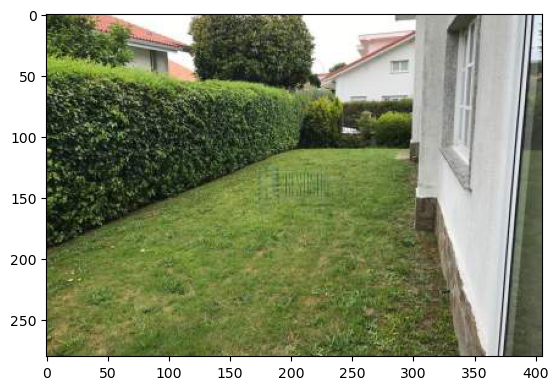

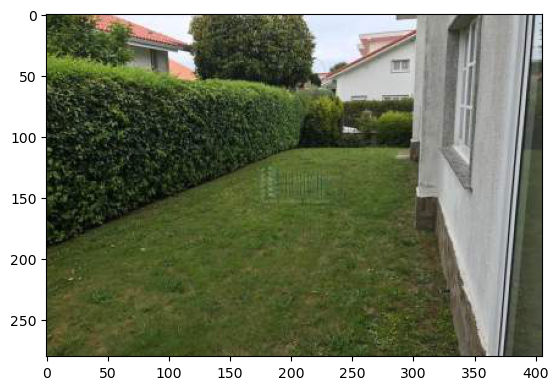

In [30]:
import PIL
import urllib.request
import matplotlib.pyplot as plt

# plot all the images in the images column in the first row
for i in range(len(df['images'][0])):
    plt.imshow(np.array(PIL.Image.open(urllib.request.urlopen(df['images'][0][i]))))
    plt.show()